# Compare SUMup observations with SNOWPACK and CFM output

#### Author: Megan Thompson-Munson
#### Date created: 23 September 2021

## User input

In [359]:
icesheet = 'GrIS'

path = '/projects/metm9666/snowpack/Scripts/Spinup/output/'

## Import libraries and set up plotting

In [360]:
# Import libraries
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import cartopy
import cartopy.crs as ccrs
from cartopy.mpl.geoaxes import GeoAxes
import cartopy.io.shapereader as shpreader
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import warnings
warnings.simplefilter("ignore", UserWarning)

# Set up plotting aesthetics
mpl.rcParams['font.family'] = 'DejaVu Sans'
mpl.rcParams['font.size'] = 10
mpl.rcParams['mathtext.fontset'] = 'cm'
mpl.rcParams['mathtext.default'] = 'regular'
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('svg')

## Read in data from pickle files

In [361]:
# Raw data dictionaries
data = pickle.load(open(icesheet+'_data.p','rb'))

# Interpoalted data dictionaries
dataInt = pickle.load(open(icesheet+'_data_interpolated.p','rb'))

## Analysis and plotting

### Statistical functions

In [362]:
# Function for calculating mean absolute percentage error (MAPE)
def MAPE(observation,measurement):
    n = len(observation)
    diff = np.abs((observation-measurement)/observation)
    mape = (1/n)*np.sum(diff)
    return mape

### Density profiles

#### Uninterpolated

In [363]:
# N = np.random.choice(len(data),4)
N = [404,17,343,269,257]

fig, ax = plt.subplots(1, len(N), figsize=(len(N)*3.1,6))

for i in range(len(N)):
    
    d = N[i]
    
    # Datasets
    su = data[d]['SUMup']
    sp = data[d]['SNOWPACK']
    
    # Data arrays
    suDensity = su['Density']
    suDepth = su['Midpoint']
    spDensity = sp['Density']
    spDepth = sp['Depth']
    
    # Label information
    suLat = su['Latitude']
    suLon = su['Longitude']
    suElev = su['Elevation']
    suID = su['CoreID']
    suDate = str(su['Timestamp'])[:10]
    spLat = sp['Latitude']
    spLon = sp['Longitude']
    spElev = sp['Elevation']
    spID = int(sp['ID'])
    spDate = str(sp['Timestamp'])[:10]
    
    ax[i].invert_yaxis()
    ax[i].set_ylabel('Depth (m)')
    ax[i].set_xlabel(r'Density (kg m$^{-3}$)')
    
    ax[i].scatter(suDensity,suDepth,
                  c='#003f5c',edgecolors='none',s=25,marker='o',
                  label='SUMup (ID: {})\n{:.2f}, {:.2f}\n{:.0f} m {}'.format(suID,suLat,suLon,suElev,suDate))
    ax[i].scatter(spDensity[spDepth<=max(suDepth)],spDepth[spDepth<=max(suDepth)],
                  c='#ff6361',edgecolors='none',s=25,marker='o',
                  label='SNOWPACK (ID: {})\n{:.2f}, {:.2f}\n{:.0f} m {}'.format(spID,spLat,spLon,spElev,spDate))
    
    legend = ax[i].legend(prop={'size':8}, bbox_to_anchor=(0,1.015), loc='lower left')
    legend.get_frame().set_edgecolor('k')
    legend.get_frame().set_boxstyle('Square')
    
    # Add inset map
    if icesheet=='GrIS':
        ax_map = inset_axes(ax[i], width=0.75, height=0.92, bbox_to_anchor=(1.02,1.02),bbox_transform=ax[i].transAxes, 
                            loc='lower right', borderpad=0,
                            axes_class=cartopy.mpl.geoaxes.GeoAxes, 
                            axes_kwargs=dict(map_projection=ccrs.NorthPolarStereo(central_longitude=-45)))
        ax_map.set_extent([-60, -28, 58, 85], ccrs.PlateCarree())

    ax_map.axes.xaxis.set_ticks([])
    ax_map.axes.yaxis.set_ticks([])
    ax_map.coastlines(resolution='110m',color='#808080',zorder=0)
    ax_map.scatter(spLon,spLat,transform=ccrs.PlateCarree(),
                   color='k',s=40,edgecolors='none',marker='*')
    
plt.tight_layout()

#### Interpolated

In [364]:
N = [403,17,342,268]

fig, ax = plt.subplots(1, len(N), figsize=(len(N)*3.1,6))

for i in range(len(N)):
    
    d = N[i]
    
    # Datasets
    su = dataInt[d]['SUMup']
    sp = dataInt[d]['SNOWPACK']
    
    # Data arrays
    suDensity = su['Density']
    suDepth = su['Depth']
    spDensity = sp['Density']
    spDepth = sp['Depth']
    
    # Label information
    suLat = su['Latitude']
    suLon = su['Longitude']
    suElev = su['Elevation']
    suID = su['CoreID']
    suDate = str(su['Timestamp'])[:10]
    spLat = sp['Latitude']
    spLon = sp['Longitude']
    spElev = sp['Elevation']
    spID = int(sp['ID'])
    spDate = str(sp['Timestamp'])[:10]
    
    ax[i].invert_yaxis()
    ax[i].set_ylabel('Depth (m)')
    ax[i].set_xlabel(r'Density (kg m$^{-3}$)')
    
    ax[i].scatter(suDensity,suDepth,
                  c='#003f5c',edgecolors='none',s=25,marker='o',
                  label='SUMup (ID: {})\n{:.2f}, {:.2f}\n{:.0f} m {}'.format(suID,suLat,suLon,suElev,suDate))
    ax[i].scatter(spDensity[spDepth<=max(suDepth)],spDepth[spDepth<=max(suDepth)],
                  c='#ff6361',edgecolors='none',s=25,marker='o',
                  label='SNOWPACK (ID: {})\n{:.2f}, {:.2f}\n{:.0f} m {}'.format(spID,spLat,spLon,spElev,spDate))
    
    legend = ax[i].legend(prop={'size':8}, bbox_to_anchor=(0,1.015), loc='lower left')
    legend.get_frame().set_edgecolor('k')
    legend.get_frame().set_boxstyle('Square')
    
    # Add inset map
    if icesheet=='GrIS':
        ax_map = inset_axes(ax[i], width=0.75, height=0.92, bbox_to_anchor=(1.02,1.02),bbox_transform=ax[i].transAxes, 
                            loc='lower right', borderpad=0,
                            axes_class=cartopy.mpl.geoaxes.GeoAxes, 
                            axes_kwargs=dict(map_projection=ccrs.NorthPolarStereo(central_longitude=-45)))
        ax_map.set_extent([-60, -28, 58, 85], ccrs.PlateCarree())

    ax_map.axes.xaxis.set_ticks([])
    ax_map.axes.yaxis.set_ticks([])
    ax_map.coastlines(resolution='110m',color='#808080',zorder=0)
    ax_map.scatter(spLon,spLat,transform=ccrs.PlateCarree(),
                   color='k',s=40,edgecolors='none',marker='*')
    
    mape = MAPE(suDensity,spDensity)
    ax[i].text(0.02,0.02,'MAPE: {:.3f}'.format(mape),transform=ax[i].transAxes, )
    
plt.tight_layout()

### Firn air content

In [354]:
# Empty lists for storing calculated FAC
suFAC = []
spFAC = []
suDmax = []
spDmax = []

for i in range(len(data)):
# for i in range(257,258):
    
    # Datasets
    su = data[i]['SUMup']
    sp = data[i]['SNOWPACK']
    
    ### SUMup ###
    
    # SUMup data arrays
    suDensity = su['Density']
    suMidpoint = su['Midpoint']
    suStartDepth = su['StartDepth']
    suStopDepth = su['StopDepth']
    suThickness = su['Thickness']
    
    # Calculate SUMup thicknesses
    if suThickness[0] == 0:
        suThickness = suMidpoint[1:]-suMidpoint[:-1]
        suThickness = np.insert(suThickness,0,suMidpoint[0])
        sudmax = max(suMidpoint)
        suDmax.append(sudmax)
    else:
        sudmax = max(suStopDepth)
        suDmax.append(sudmax)
    
    # If SUMup density is greater than 917, make it 917 in order to avoid negative FAC
    suDensity = np.where(suDensity>917,917,suDensity)
    
    # Calculate fractional air content and FAC; scale by height 
    suAir = (917-np.array(suDensity))/917
    
    if i == 257: # add 258
        sufac = np.sum(suThickness[1:]*suAir[1:]) * (sudmax/np.sum(suThickness[1:]))
        suFAC.append(sufac)
    else:    
        sufac = np.sum(suThickness*suAir) * (sudmax/np.sum(suThickness))
        suFAC.append(sufac)
    
    ### SNOWPACK ###
    
    # SNOWPACK data arrays
    spDensity = sp['Density']
    spDepth = sp['Depth']
    spHeight = sp['Height']
    spAir = sp['Air']
    
    # Calculate SNOWPACK thicknesses and max thickness
    spThickness = spHeight[1:] - spHeight[:-1]
    spThickness = np.insert(spThickness,0,spHeight[0])
    spdmax = max(spDepth[spDepth<sudmax])
    spDmax.append(spdmax)
    
    # Calculate FAC
    spfac = np.sum(spThickness[spDepth<sudmax]*spAir[spDepth<sudmax])
    spFAC.append(spfac)

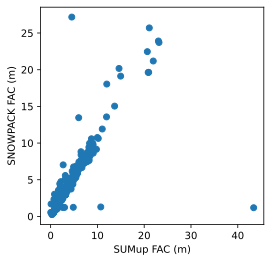

In [355]:
fig, ax = plt.subplots(1,figsize=(4,4))

suFAC = np.array(suFAC)
spFAC = np.array(spFAC)

ax.set_xlabel('SUMup FAC (m)')
ax.set_ylabel('SNOWPACK FAC (m)')

ax.scatter(suFAC[suFAC>0],spFAC[suFAC>0])

In [356]:
np.where(np.array(suFAC)>40)

(array([258]),)

In [358]:
data[258]['SUMup']

{'CoreID': 300,
 'Citation': 25.0,
 'Timestamp': numpy.datetime64('2015-05-22T00:00:00.000000000'),
 'Latitude': 76.32535,
 'Longitude': -43.06116,
 'Elevation': 2782.0,
 'Midpoint': array([1.00083506, 0.003135  , 0.003265  , ..., 1.99583507, 1.995965  ,
        1.99609494]),
 'StartDepth': array([1.9986 , 0.00307, 0.0032 , ..., 1.99577, 1.9959 , 1.99603],
       dtype=float32),
 'StopDepth': array([0.00307, 0.0032 , 0.00333, ..., 1.9959 , 1.99603, 1.99616],
       dtype=float32),
 'Thickness': array([-1.9955300e+00,  1.2999983e-04,  1.3000006e-04, ...,
         1.3005733e-04,  1.2993813e-04,  1.3005733e-04], dtype=float32),
 'Density': array([297.19998, 298.59998, 299.4    , ..., 328.4    , 328.4    ,
        324.9    ], dtype=float32)}

### Critical densities